In [3]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader, Dataset

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

Using device: cuda


## 一、ResNet Block  
### 1.basic block
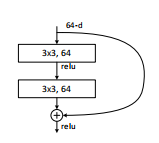 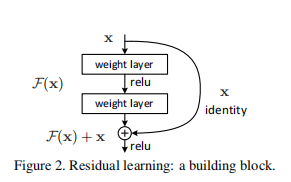
* basic block主要用来构建ResNet18和ResNet34网络，包含 2个卷积层、快捷连接  
  * 卷积层：  
    使用了两个3*3的卷积，卷积后接着BN和ReLU
  * 快捷连接（shortcut connections）：  
    当 *stride=1且通道数相同* 时，进行**恒等映射**  
    当 *需要下采样或改变通道数* 时，使用**1x1卷积**进行调整

In [ ]:
class BasicBlock(nn.Module):
  def __init__(self, inchannels, outchannels, stride=1):
    super().__init__()
    self.left_path = nn.Sequential(
      nn.Conv2d(inchannels, outchannels, kernel_size=3, stride=stride, padding=1, bias=False),
      nn.BatchNorm2d(outchannels),
      nn.ReLU(inplace=True),
      nn.Conv2d(outchannels, outchannels, kernel_size=3, stride=1, padding=1, bias=False),
      nn.BatchNorm2d(outchannels),
    )
    if stride != 1 or inchannels != outchannels:
      self.shortcut = nn.Sequential(
        nn.Conv2d(inchannels, outchannels, kernel_size=1, stride=stride, bias=False),   # 1x1卷积
        nn.BatchNorm2d(outchannels)
      )
    else:
      self.shortcut = nn.Sequential()

  def forward(self, x):
    out = self.left_path(x)
    out += self.shortcut(x)
    out = nn.ReLU(inplace=True)(out)
    return out
    

由于在进行图像识别等任务时，需要对图像进行 *长度宽度减半（stride=2）、增加通道数（inchannels != outchannels）* 的变换，导致了left_path的输出图像和identity尺寸不一致，无法进行相加的情况。  
所以在进行残差连接时，要使用 *1x1卷积* 调整identity的尺寸保证维度匹配，流程如下：  
根据卷积尺寸计算公式：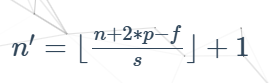
1. 长度宽度减半（stride=2）  
只需将1x1卷积的stride置为2即可  
n1 = (i+2*1-3)//2+1  
n2 = (i+0-1)//2+1  
n1 = n2  
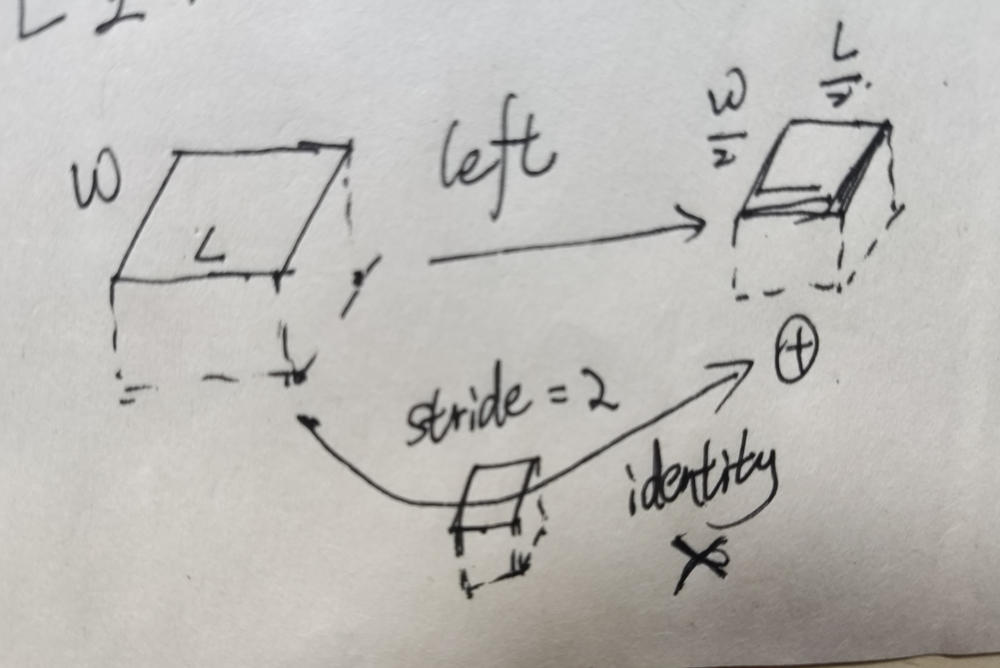

2. 增加通道数（inchannels != outchannels）  
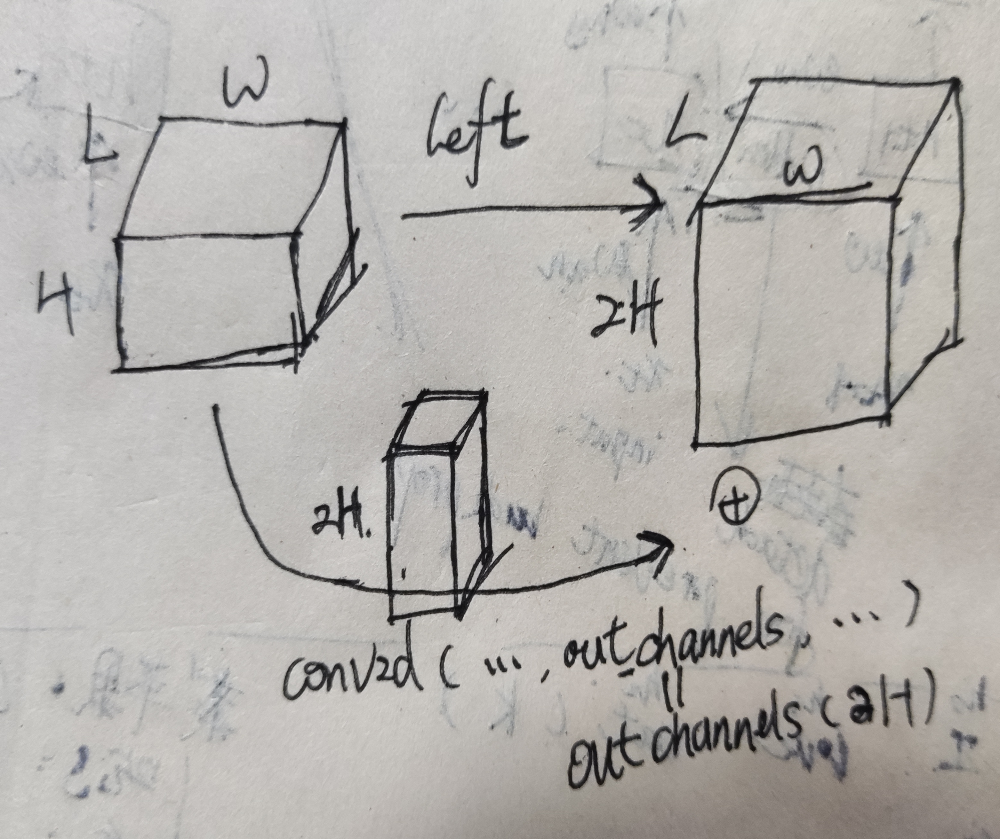

### 2.bottleneck block
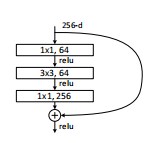 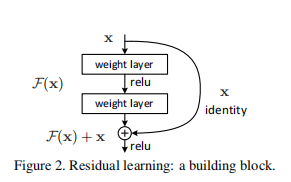
* bottleneck主要用来构建ResNet50以上的网络，包含 3个卷积层、快捷连接  
  * 卷积层：  
    分别使用了1x1、3x3、1x1卷积，分别用于压缩维度、卷积处理、恢复维度，卷积后接着BN和ReLU  
    1x1卷积：大幅减少通道数，降低计算复杂度  
    3x3卷积：在低维空间进行主要的特征提取  
    1x1卷积：将特征维度恢复到期望的输出通道数  
  * 快捷连接（shortcut connections）：  
    当 *stride=1且通道数相同* 时，进行**恒等映射**  
    当 *需要下采样或改变通道数* 时，使用**1x1卷积**进行调整

In [ ]:
class Bottleneck(nn.Module):
  def __init__(self, inchannels, outchannels, stride=1):
    super().__init__()
    self.left_path = nn.Sequential(
      nn.Conv2d(inchannels, int(outchannels/4), kernel_size=1, stride=stride, padding=0, bias=False),  # 压缩维度
      nn.BatchNorm2d(int(outchannels/4)),
      nn.ReLU(inplace=True),
      nn.Conv2d(int(outchannels/4), int(outchannels/4), kernel_size=3, stride=1, padding=1, bias=False),  # 卷积处理
      nn.BatchNorm2d(int(outchannels/4)),
      nn.ReLU(inplace=True),
      nn.Conv2d(int(outchannels/4), outchannels, kernel_size=1, stride=1, bias=False),  # 恢复维度
      nn.BatchNorm2d(outchannels)
    )
    if stride != 1 or inchannels != outchannels:
      self.shortcut = nn.Sequential(
        nn.Conv2d(inchannels, outchannels, kernel_size=1, stride=stride, bias=False),   # 1x1卷积
        nn.BatchNorm2d(outchannels)
      )
    else:
      self.shortcut = nn.Sequential()

  def forward(self, x):
    out = self.left_path(x)
    out += self.shortcut(x)
    out = nn.ReLU(inplace=True)(out)
    return out

## 二、ResNet整体框架&模型
大体流程：  
  - 输入x  
  -> 初始卷积层（降低输入分辨率、提取低级特征、扩展通道数）  
  -> 最大池化层（进行下采样）  
  -> 残差层第一层（提取基础特征）  
  -> 残差层第二层（提取中级特征）  
  -> 残差层第三层（提取高级特征，物体部件和结构）  
  -> 残差层第四层（提取语义特征，最高级别的语义信息）  
  -> 分类头（执行最终的分类策略）

残差层结构：  
  - 由 `num_blocks` 个残差块 `block` 构成，决定最终输出的特征图的尺寸，通过通道数 `outchannels` 以及是否进行下采样 `stride` 决定。
  - 具体来说，通过 `_make_layer(...)` 函数创建各个残差层，该函数在处理第一个残差块时就得到了最终输出的特征图的尺寸，之后的残差块采用 `stride=1 self.in_channels=outchannels` 的方式保持该尺寸。

In [109]:
class ResNet(nn.Module):
  def __init__(self, block, num_blocks, num_classes=1000):
    super().__init__()
    self.in_channels = 64

    self.conv1 = nn.Sequential(
      nn.Conv2d(3, self.in_channels, kernel_size=7, stride=2, padding=3, bias=False),
      nn.BatchNorm2d(self.in_channels),
      nn.ReLU(inplace=True),
    )
    self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)   # 增加感受野

    self.layer1 = self._make_layer(block, self.in_channels, num_blocks[0], stride=1)
    self.layer2 = self._make_layer(block, self.in_channels*2, num_blocks[1], stride=2)
    self.layer3 = self._make_layer(block, self.in_channels*2, num_blocks[2], stride=2)
    self.layer4 = self._make_layer(block, self.in_channels*2, num_blocks[3], stride=2)
    
    self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
    self.fc = nn.Linear(self.in_channels, num_classes)
    self._init_weights()

  def _make_layer(self, block, outchannels, num_blocks, stride):
    strides = [stride]+[1]*(num_blocks-1)   # 第一个block可能需要下采样，后续的block不需要 [2, 1, 1... 1]
    layers = []
    for stride in strides:
      layers.append(block(self.in_channels, outchannels, stride))
      self.in_channels = outchannels
    return nn.Sequential(*layers)
  
  def _init_weights(self):
    for m in self.modules():
      if isinstance(m, nn.Conv2d):
        nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
      elif isinstance(m, nn.BatchNorm2d):
        nn.init.constant_(m.weight, 1)
        nn.init.constant_(m.bias, 0)
      
  def forward(self, x):
    # x: [batch_size, 3, 224, 224]
    x = self.conv1(x)       # kernel=7x7, stride=2, padding=3 -> [batch_size, 64, 112, 112]
    x = self.maxpool(x)     # -> [batch_size, 64, 56, 56]

    x = self.layer1(x)      # -> [batch_size, 64, 56, 56]
    x = self.layer2(x)      # -> [batch_size, 128, 28, 28]
    x = self.layer3(x)      # -> [batch_size, 256, 14, 14]
    x = self.layer4(x)      # -> [batch_size, 512, 7, 7]

    x = self.avgpool(x)     # -> [batch_size, 512, 1, 1]
    x = torch.flatten(x, 1) # -> [batch_size, 512]
    x = self.fc(x)          # -> [batch_size, num_classes]
    return x

# 论文中的ResNet变体
def ResNet18(num_classes=1000):
  return ResNet(BasicBlock, [2, 2, 2, 2], num_classes)
def ResNet34(num_classes=1000):
  return ResNet(BasicBlock, [3, 4, 6, 3], num_classes)
def ResNet50(num_classes=1000):
  return ResNet(Bottleneck, [3, 4, 6, 3], num_classes)
def ResNet101(num_classes=1000):
  return ResNet(Bottleneck, [3, 4, 23, 3], num_classes)
def ResNet152(num_classes=1000):
  return ResNet(Bottleneck, [3, 8, 36, 3], num_classes)

model = ResNet18(num_classes=1000)
x = torch.randn(1, 3, 224, 224)   # 1张224×224的RGB图像
# x = torch.randn(1, 1, 224, 224)
output = model(x)
print(f'output shape: {output.shape}')
total_params = sum(p.numel() for p in model.parameters())
print(f'Total number of parameters: {total_params}')


output shape: torch.Size([1, 1000])
Total number of parameters: 11689512


## 三、ResNet项目实践&效果展示
如下是训练过程中的通用模块以及显示函数
- DataLoaderFactory()
负责为datasets提供通用接口。
- Trainer()
负责执行训练的流程（train函数）以及模型的评估（evaluate函数）  
  - 包含核心部件：  
    - criterion为损失函数器，负责计算损失函数。  
    - optimizer为优化器，负责根据损失的梯度更新模型。  
    - scheduler为学习率调度器，用于动态调整训练过程中的学习率。  
  - 训练流程大致为：  
  ->加载一个batch的数据`self.train_loader = train_loader`  
  ->清零梯度`self.optimizer.zero_grad()`  
  ->前向传播`outputs = self.model(inputs)`  
  ->计算损失`loss = self.criterion(outputs, targets)`  
  ->反向传播计算梯度`loss.backward()`  
  ->优化器更新参数`self.optimizer.step()`  
  训练完一趟后  
  ->更新学习率`self.scheduler.step()`

  - 评估流程大致与训练流程一致，只不过不需要梯度的参与：  
  ->取消梯度传播`with torch.no_grad():`  
  ->前向传播`outputs = self.model(inputs)`  
  ->计算损失`loss = self.criterion(outputs, targets)`  
  ->统计  


In [ ]:
from tqdm import tqdm
import matplotlib.pyplot as plt
import time

class DataLoaderFactory:
  def __init__(self, dataset, batch_size=32, num_workers=2):
    self.batch_size = batch_size
    self.num_workers = num_workers
    self.dataset = dataset
  
  def get_dataloaders(self, root, train_transform, val_transform):
    train_dataset = self.dataset(root=root, transform=train_transform, train=True)
    val_dataset = self.dataset(root=root, transform=val_transform, train=False)
    train_loader = DataLoader(
      train_dataset,
      batch_size=self.batch_size,
      shuffle=True,
      num_workers=self.num_workers
    )
    val_loader = DataLoader(
      val_dataset,
      batch_size=self.batch_size,
      shuffle=False,
      num_workers=self.num_workers
    )
    return train_loader, val_loader

class Trainer:
  def __init__(self, model: nn.Module, train_loader: DataLoader, val_loader: DataLoader, 
               criterion: nn.Module, optimizer: optim.Optimizer, scheduler=None):
    self.model = model
    self.train_loader = train_loader
    self.val_loader = val_loader
    self.criterion = criterion
    self.optimizer = optimizer
    self.scheduler = scheduler
    self.train_losses = []
    self.val_losses = []
    self.train_accuracies = []
    self.val_accuracies = []
    self.best_val_accuracy = 0.0
  
  def train_epoch(self):
    self.model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    pbar = tqdm(self.train_loader, desc='Training', unit='batch')
    for batch_idx, (inputs, targets) in enumerate(pbar):
      inputs, targets = inputs.to(device), targets.to(device)

      self.optimizer.zero_grad()
      outputs = self.model(inputs)
      loss = self.criterion(outputs, targets)
      loss.backward()
      self.optimizer.step()

      running_loss += loss.item()*inputs.size(0)
      _, predicted = outputs.max(1)
      total += targets.size(0)
      correct += predicted.eq(targets).sum().item()
      pbar.set_postfix({'loss': running_loss/total, 'accuracy': 100.*correct/total})
    
    epoch_loss = running_loss / total
    epoch_accuracy = 100.*correct/total
    return epoch_loss, epoch_accuracy

  def validate_epoch(self):
    self.model.eval()
    running_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
      pbar = tqdm(self.val_loader, desc='Validating', unit='batch')
      for batch_idx, (inputs, targets) in enumerate(pbar):
        inputs, targets = inputs.to(device), targets.to(device)

        outputs = self.model(inputs)
        loss = self.criterion(outputs, targets)

        running_loss += loss.item()*inputs.size(0)
        _, predicted = outputs.max(1)
        total += targets.size(0)
        correct += predicted.eq(targets).sum().item()
        pbar.set_postfix({'loss': running_loss/total, 'accuracy': 100.*correct/total})

    epoch_loss = running_loss / total
    epoch_accuracy = 100.*correct/total
    return epoch_loss, epoch_accuracy

  def train(self, num_epochs):
    for epoch in range(num_epochs):
      print(f'Epoch [{epoch+1}/{num_epochs}]')
      train_loss, train_accuracy = self.train_epoch()
      val_loss, val_accuracy = self.validate_epoch()

      self.train_losses.append(train_loss)
      self.val_losses.append(val_loss)
      self.train_accuracies.append(train_accuracy)
      self.val_accuracies.append(val_accuracy)

      if self.scheduler:
        self.scheduler.step()
      
      print(f'Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%')
      print(f'Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%')

  def evaluate(self, test_loader):
    self.model.eval()
    correct = 0
    total = 0

    with torch.no_grad():
      for inputs, targets in test_loader:
        inputs, targets = inputs.to(device), targets.to(device)

        outputs = self.model(inputs)
        _, predicted = outputs.max(1)
        total += targets.size(0)
        correct += predicted.eq(targets).sum().item()
    accuracy = 100.*correct/total
    return accuracy

def plot_train_history(trainer):
  epochs = range(1, len(trainer.train_losses)+1)

  plt.figure(figsize=(12, 5))

  plt.subplot(1, 2, 1)
  plt.plot(epochs, trainer.train_losses, 'b-', label='Training Loss')
  plt.plot(epochs, trainer.val_losses, 'r-', label='Validation Loss')
  plt.title('Loss over Epochs')
  plt.xlabel('Epochs')
  plt.ylabel('Loss')
  plt.legend()

  plt.subplot(1, 2, 2)
  plt.plot(epochs, trainer.train_accuracies, 'b-', label='Training Accuracy')
  plt.plot(epochs, trainer.val_accuracies, 'r-', label='Validation Accuracy')
  plt.title('Accuracy over Epochs')
  plt.xlabel('Epochs')
  plt.ylabel('Accuracy (%)')
  plt.legend()

  plt.show()


1. 使用CIFAR-10数据集进行图像分类：
  - CIFAR-10 是由10个类别的60000张32x32彩色图像组成，每个类别有6000张图像。数据集被分为50000张训练图像和10000张测试图像。
  在前6趟测试中，ResNet18的准确度测试结果（79.91%）要优于CNN（76.07%），但ResNet50的表现并不好（47.24%）  
  ResNet18:  
  ![image-2.png](attachment:image-2.png)  
  CNN:  
  ![image.png](attachment:image.png)  

In [ ]:
# CIFAR10数据集
class CIFAR10Dataset(Dataset):
  def __init__(self, root, transform=None, train=True):
    self.dataset = datasets.CIFAR10(root=root, train=train, 
                                    download=True, transform=transform)

  def __len__(self):
    return len(self.dataset)
  
  def __getitem__(self, idx):
    return self.dataset[idx]

torch.manual_seed(42)
num_classes = 10
batch_size = 64
learning_rate = 0.1
momentum = 0.9
# weight_decay = 5e-4
epochs = 10
step_size = 10
gamma = 0.1
num_workers = 0

train_transform = transforms.Compose([
  # transforms.RandomResizedCrop(224),
  transforms.Resize((224, 224)),
  transforms.RandomHorizontalFlip(p=0.5),
  transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
  transforms.ToTensor(),
  transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
val_transform = transforms.Compose([
  # transforms.Resize(256),
  transforms.Resize((224, 224)),
  # transforms.CenterCrop(224),
  transforms.ToTensor(),
  transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

print('loading data...')
data_loader_factory = DataLoaderFactory(dataset=CIFAR10Dataset, batch_size=batch_size, num_workers=num_workers)
train_loader, val_loader = data_loader_factory.get_dataloaders(root='./data',
                                                               train_transform=train_transform,
                                                               val_transform=val_transform)

print('initializing model...')
model = ResNet50(num_classes=num_classes).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(
  model.parameters(),
  lr=learning_rate,
  momentum=momentum,
  # weight_decay=weight_decay
)
scheduler = optim.lr_scheduler.StepLR(
  optimizer,
  step_size=step_size,
  gamma=gamma
)

print('starting training...')
trainer = Trainer(
  model=model,
  train_loader=train_loader,
  val_loader=val_loader,
  criterion=criterion,
  optimizer=optimizer,
  scheduler=scheduler
)
start_time = time.time()
trainer.train(num_epochs=epochs)
end_time = time.time()
print(f'Training completed in: {end_time - start_time:.2f} seconds')
plot_train_history(trainer)

loading data...
initializing model...
starting training...
Epoch [1/10]


Validating: 100%|██████████| 157/157 [00:10<00:00, 14.84batch/s, loss=1.85, accuracy=28.1]


Train Loss: 2.0534, Train Accuracy: 21.20%
Val Loss: 1.8476, Val Accuracy: 28.06%
Epoch [2/10]


Validating: 100%|██████████| 157/157 [00:09<00:00, 15.90batch/s, loss=1.72, accuracy=35]  


Train Loss: 1.8185, Train Accuracy: 31.61%
Val Loss: 1.7161, Val Accuracy: 34.95%
Epoch [3/10]


Validating: 100%|██████████| 157/157 [00:10<00:00, 14.62batch/s, loss=1.6, accuracy=40.3]


Train Loss: 1.7068, Train Accuracy: 36.46%
Val Loss: 1.6017, Val Accuracy: 40.34%
Epoch [4/10]


Validating: 100%|██████████| 157/157 [00:09<00:00, 15.75batch/s, loss=1.52, accuracy=43.9]


Train Loss: 1.6239, Train Accuracy: 39.95%
Val Loss: 1.5153, Val Accuracy: 43.89%
Epoch [5/10]


Validating: 100%|██████████| 157/157 [00:10<00:00, 14.61batch/s, loss=1.45, accuracy=46.5]


Train Loss: 1.5557, Train Accuracy: 42.73%
Val Loss: 1.4487, Val Accuracy: 46.46%
Epoch [6/10]


Validating: 100%|██████████| 157/157 [00:11<00:00, 14.22batch/s, loss=1.42, accuracy=47.2]


Train Loss: 1.4912, Train Accuracy: 44.88%
Val Loss: 1.4231, Val Accuracy: 47.24%
Epoch [7/10]


Validating: 100%|██████████| 157/157 [00:10<00:00, 15.27batch/s, loss=1.35, accuracy=50.1]


Train Loss: 1.4259, Train Accuracy: 47.88%
Val Loss: 1.3456, Val Accuracy: 50.08%
Epoch [8/10]


Validating: 100%|██████████| 157/157 [00:10<00:00, 14.66batch/s, loss=1.29, accuracy=52.6]


Train Loss: 1.3648, Train Accuracy: 50.28%
Val Loss: 1.2914, Val Accuracy: 52.65%
Epoch [9/10]


Training:  17%|█▋        | 130/782 [00:52<04:21,  2.49batch/s, loss=1.34, accuracy=51.6]


KeyboardInterrupt: 

2. 使用ORL数据集进行人脸识别：
  - ORL（Olivetti Research Laboratory）人脸数据集，包含400张灰度图，分为40个人，图像尺寸92x112像素，是人脸识别领域最经典、最广泛使用的基准数据集之一，尤其在早期人脸识别算法研究和教学中具有重要地位，使用ResNet50训练30趟达到了83%的准确率。


<>:83: SyntaxWarning: invalid escape sequence '\d'
<>:83: SyntaxWarning: invalid escape sequence '\d'
C:\Users\Administrator\AppData\Local\Temp\ipykernel_16240\3656650996.py:83: SyntaxWarning: invalid escape sequence '\d'
  train_loader, val_loader = data_loader_factory.get_dataloaders(root='.\data',


loading data...
Found 400 image files
Training set: 320 images
Found 400 image files
Testing set: 80 images
initializing model...
starting training...
Epoch [1/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 66.30batch/s, loss=14.9, accuracy=0]


Train Loss: 4.1650, Train Accuracy: 5.94%
Val Loss: 14.9062, Val Accuracy: 0.00%
Epoch [2/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 65.79batch/s, loss=5.58, accuracy=8.75]


Train Loss: 3.3628, Train Accuracy: 10.00%
Val Loss: 5.5846, Val Accuracy: 8.75%
Epoch [3/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.91batch/s, loss=2.29, accuracy=32.5]


Train Loss: 2.8432, Train Accuracy: 16.25%
Val Loss: 2.2908, Val Accuracy: 32.50%
Epoch [4/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 57.94batch/s, loss=4.02, accuracy=15] 


Train Loss: 2.7011, Train Accuracy: 20.31%
Val Loss: 4.0196, Val Accuracy: 15.00%
Epoch [5/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.57batch/s, loss=2.33, accuracy=31.2]


Train Loss: 2.5110, Train Accuracy: 26.56%
Val Loss: 2.3270, Val Accuracy: 31.25%
Epoch [6/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 56.31batch/s, loss=1.45, accuracy=56.2]


Train Loss: 1.9905, Train Accuracy: 35.62%
Val Loss: 1.4521, Val Accuracy: 56.25%
Epoch [7/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.72batch/s, loss=1.56, accuracy=47.5]


Train Loss: 1.6746, Train Accuracy: 47.50%
Val Loss: 1.5578, Val Accuracy: 47.50%
Epoch [8/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 52.71batch/s, loss=1.73, accuracy=46.2]


Train Loss: 1.7705, Train Accuracy: 44.06%
Val Loss: 1.7337, Val Accuracy: 46.25%
Epoch [9/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.34batch/s, loss=1.68, accuracy=37.5]


Train Loss: 1.5606, Train Accuracy: 43.75%
Val Loss: 1.6770, Val Accuracy: 37.50%
Epoch [10/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 66.00batch/s, loss=0.866, accuracy=76.2]


Train Loss: 1.4752, Train Accuracy: 51.88%
Val Loss: 0.8655, Val Accuracy: 76.25%
Epoch [11/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 65.63batch/s, loss=0.464, accuracy=88.8]


Train Loss: 1.1998, Train Accuracy: 62.19%
Val Loss: 0.4642, Val Accuracy: 88.75%
Epoch [12/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.70batch/s, loss=0.688, accuracy=73.8]


Train Loss: 0.9860, Train Accuracy: 67.19%
Val Loss: 0.6880, Val Accuracy: 73.75%
Epoch [13/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 65.02batch/s, loss=0.634, accuracy=81.2]


Train Loss: 0.9906, Train Accuracy: 65.94%
Val Loss: 0.6342, Val Accuracy: 81.25%
Epoch [14/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.57batch/s, loss=0.705, accuracy=75] 


Train Loss: 0.9261, Train Accuracy: 73.44%
Val Loss: 0.7048, Val Accuracy: 75.00%
Epoch [15/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 65.30batch/s, loss=0.805, accuracy=71.2]


Train Loss: 1.0084, Train Accuracy: 67.50%
Val Loss: 0.8052, Val Accuracy: 71.25%
Epoch [16/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.69batch/s, loss=0.337, accuracy=91.2]


Train Loss: 0.7508, Train Accuracy: 79.69%
Val Loss: 0.3372, Val Accuracy: 91.25%
Epoch [17/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 60.42batch/s, loss=0.359, accuracy=90] 


Train Loss: 0.5643, Train Accuracy: 85.31%
Val Loss: 0.3586, Val Accuracy: 90.00%
Epoch [18/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.45batch/s, loss=0.328, accuracy=91.2]


Train Loss: 0.5856, Train Accuracy: 82.50%
Val Loss: 0.3282, Val Accuracy: 91.25%
Epoch [19/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 65.48batch/s, loss=0.22, accuracy=95]  


Train Loss: 0.4224, Train Accuracy: 88.75%
Val Loss: 0.2200, Val Accuracy: 95.00%
Epoch [20/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.34batch/s, loss=0.352, accuracy=91.2]


Train Loss: 0.4672, Train Accuracy: 86.56%
Val Loss: 0.3525, Val Accuracy: 91.25%
Epoch [21/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 59.82batch/s, loss=0.268, accuracy=92.5]


Train Loss: 0.4099, Train Accuracy: 87.50%
Val Loss: 0.2681, Val Accuracy: 92.50%
Epoch [22/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.43batch/s, loss=0.264, accuracy=91.2]


Train Loss: 0.3591, Train Accuracy: 90.94%
Val Loss: 0.2639, Val Accuracy: 91.25%
Epoch [23/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.86batch/s, loss=0.175, accuracy=93.8]


Train Loss: 0.3367, Train Accuracy: 90.62%
Val Loss: 0.1746, Val Accuracy: 93.75%
Epoch [24/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.30batch/s, loss=0.18, accuracy=96.2]


Train Loss: 0.3203, Train Accuracy: 91.88%
Val Loss: 0.1805, Val Accuracy: 96.25%
Epoch [25/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.35batch/s, loss=0.161, accuracy=95] 


Train Loss: 0.3278, Train Accuracy: 90.94%
Val Loss: 0.1612, Val Accuracy: 95.00%
Epoch [26/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.75batch/s, loss=0.133, accuracy=97.5]


Train Loss: 0.2360, Train Accuracy: 94.69%
Val Loss: 0.1331, Val Accuracy: 97.50%
Epoch [27/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.33batch/s, loss=0.127, accuracy=98.8]


Train Loss: 0.2653, Train Accuracy: 90.94%
Val Loss: 0.1271, Val Accuracy: 98.75%
Epoch [28/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.86batch/s, loss=0.14, accuracy=98.8]


Train Loss: 0.2386, Train Accuracy: 92.50%
Val Loss: 0.1396, Val Accuracy: 98.75%
Epoch [29/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 65.17batch/s, loss=0.155, accuracy=98.8]


Train Loss: 0.3064, Train Accuracy: 90.62%
Val Loss: 0.1552, Val Accuracy: 98.75%
Epoch [30/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.88batch/s, loss=0.121, accuracy=96.2]


Train Loss: 0.1945, Train Accuracy: 94.06%
Val Loss: 0.1205, Val Accuracy: 96.25%
Epoch [31/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.57batch/s, loss=0.138, accuracy=96.2]


Train Loss: 0.2068, Train Accuracy: 94.69%
Val Loss: 0.1380, Val Accuracy: 96.25%
Epoch [32/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.34batch/s, loss=0.123, accuracy=97.5]


Train Loss: 0.2204, Train Accuracy: 93.75%
Val Loss: 0.1234, Val Accuracy: 97.50%
Epoch [33/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 58.83batch/s, loss=0.122, accuracy=97.5]


Train Loss: 0.2226, Train Accuracy: 94.06%
Val Loss: 0.1221, Val Accuracy: 97.50%
Epoch [34/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.17batch/s, loss=0.144, accuracy=96.2]


Train Loss: 0.1802, Train Accuracy: 95.31%
Val Loss: 0.1441, Val Accuracy: 96.25%
Epoch [35/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 58.18batch/s, loss=0.099, accuracy=97.5]


Train Loss: 0.1850, Train Accuracy: 95.94%
Val Loss: 0.0990, Val Accuracy: 97.50%
Epoch [36/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.12batch/s, loss=0.0936, accuracy=98.8]


Train Loss: 0.2048, Train Accuracy: 95.62%
Val Loss: 0.0936, Val Accuracy: 98.75%
Epoch [37/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 55.08batch/s, loss=0.115, accuracy=97.5]


Train Loss: 0.2072, Train Accuracy: 94.06%
Val Loss: 0.1152, Val Accuracy: 97.50%
Epoch [38/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.57batch/s, loss=0.112, accuracy=97.5]


Train Loss: 0.2197, Train Accuracy: 93.12%
Val Loss: 0.1121, Val Accuracy: 97.50%
Epoch [39/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.42batch/s, loss=0.108, accuracy=97.5]


Train Loss: 0.2138, Train Accuracy: 94.06%
Val Loss: 0.1076, Val Accuracy: 97.50%
Epoch [40/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.28batch/s, loss=0.126, accuracy=96.2]


Train Loss: 0.1616, Train Accuracy: 95.31%
Val Loss: 0.1261, Val Accuracy: 96.25%
Epoch [41/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 61.70batch/s, loss=0.112, accuracy=96.2]


Train Loss: 0.1586, Train Accuracy: 95.31%
Val Loss: 0.1117, Val Accuracy: 96.25%
Epoch [42/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.82batch/s, loss=0.106, accuracy=96.2]


Train Loss: 0.2027, Train Accuracy: 95.62%
Val Loss: 0.1060, Val Accuracy: 96.25%
Epoch [43/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.26batch/s, loss=0.102, accuracy=97.5]


Train Loss: 0.1599, Train Accuracy: 95.94%
Val Loss: 0.1020, Val Accuracy: 97.50%
Epoch [44/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 58.25batch/s, loss=0.096, accuracy=97.5]


Train Loss: 0.2240, Train Accuracy: 92.81%
Val Loss: 0.0960, Val Accuracy: 97.50%
Epoch [45/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.80batch/s, loss=0.104, accuracy=97.5]


Train Loss: 0.1736, Train Accuracy: 96.56%
Val Loss: 0.1035, Val Accuracy: 97.50%
Epoch [46/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.03batch/s, loss=0.122, accuracy=97.5]


Train Loss: 0.1470, Train Accuracy: 95.00%
Val Loss: 0.1219, Val Accuracy: 97.50%
Epoch [47/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.44batch/s, loss=0.122, accuracy=97.5]


Train Loss: 0.2174, Train Accuracy: 92.81%
Val Loss: 0.1225, Val Accuracy: 97.50%
Epoch [48/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.51batch/s, loss=0.109, accuracy=97.5]


Train Loss: 0.1972, Train Accuracy: 94.69%
Val Loss: 0.1089, Val Accuracy: 97.50%
Epoch [49/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.15batch/s, loss=0.113, accuracy=97.5]


Train Loss: 0.2305, Train Accuracy: 92.50%
Val Loss: 0.1133, Val Accuracy: 97.50%
Epoch [50/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.57batch/s, loss=0.107, accuracy=98.8]


Train Loss: 0.2034, Train Accuracy: 94.06%
Val Loss: 0.1074, Val Accuracy: 98.75%
Epoch [51/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.93batch/s, loss=0.105, accuracy=98.8]


Train Loss: 0.2511, Train Accuracy: 91.25%
Val Loss: 0.1052, Val Accuracy: 98.75%
Epoch [52/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 65.95batch/s, loss=0.0935, accuracy=97.5]


Train Loss: 0.2073, Train Accuracy: 93.44%
Val Loss: 0.0935, Val Accuracy: 97.50%
Epoch [53/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.16batch/s, loss=0.107, accuracy=97.5]


Train Loss: 0.1722, Train Accuracy: 96.25%
Val Loss: 0.1066, Val Accuracy: 97.50%
Epoch [54/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.48batch/s, loss=0.124, accuracy=97.5]


Train Loss: 0.2097, Train Accuracy: 93.75%
Val Loss: 0.1244, Val Accuracy: 97.50%
Epoch [55/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.16batch/s, loss=0.102, accuracy=97.5]


Train Loss: 0.1939, Train Accuracy: 95.00%
Val Loss: 0.1021, Val Accuracy: 97.50%
Epoch [56/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.02batch/s, loss=0.107, accuracy=97.5]


Train Loss: 0.1652, Train Accuracy: 95.62%
Val Loss: 0.1067, Val Accuracy: 97.50%
Epoch [57/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 51.57batch/s, loss=0.117, accuracy=97.5]


Train Loss: 0.1668, Train Accuracy: 94.38%
Val Loss: 0.1170, Val Accuracy: 97.50%
Epoch [58/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 51.82batch/s, loss=0.104, accuracy=98.8]


Train Loss: 0.1450, Train Accuracy: 96.88%
Val Loss: 0.1036, Val Accuracy: 98.75%
Epoch [59/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.92batch/s, loss=0.0899, accuracy=98.8]


Train Loss: 0.1533, Train Accuracy: 95.94%
Val Loss: 0.0899, Val Accuracy: 98.75%
Epoch [60/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 59.94batch/s, loss=0.109, accuracy=98.8]


Train Loss: 0.1712, Train Accuracy: 96.25%
Val Loss: 0.1094, Val Accuracy: 98.75%
Epoch [61/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.36batch/s, loss=0.117, accuracy=98.8]


Train Loss: 0.1619, Train Accuracy: 94.69%
Val Loss: 0.1168, Val Accuracy: 98.75%
Epoch [62/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.45batch/s, loss=0.0947, accuracy=98.8]


Train Loss: 0.1536, Train Accuracy: 95.31%
Val Loss: 0.0947, Val Accuracy: 98.75%
Epoch [63/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 65.02batch/s, loss=0.117, accuracy=97.5]


Train Loss: 0.1698, Train Accuracy: 95.31%
Val Loss: 0.1169, Val Accuracy: 97.50%
Epoch [64/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.64batch/s, loss=0.0967, accuracy=97.5]


Train Loss: 0.1498, Train Accuracy: 97.50%
Val Loss: 0.0967, Val Accuracy: 97.50%
Epoch [65/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 65.30batch/s, loss=0.0904, accuracy=98.8]


Train Loss: 0.1956, Train Accuracy: 94.38%
Val Loss: 0.0904, Val Accuracy: 98.75%
Epoch [66/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 58.67batch/s, loss=0.109, accuracy=97.5]


Train Loss: 0.1631, Train Accuracy: 96.88%
Val Loss: 0.1093, Val Accuracy: 97.50%
Epoch [67/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 65.77batch/s, loss=0.0962, accuracy=97.5]


Train Loss: 0.1783, Train Accuracy: 93.75%
Val Loss: 0.0962, Val Accuracy: 97.50%
Epoch [68/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 59.01batch/s, loss=0.116, accuracy=97.5]


Train Loss: 0.1602, Train Accuracy: 95.94%
Val Loss: 0.1163, Val Accuracy: 97.50%
Epoch [69/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.69batch/s, loss=0.0894, accuracy=98.8]


Train Loss: 0.1800, Train Accuracy: 95.31%
Val Loss: 0.0894, Val Accuracy: 98.75%
Epoch [70/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.82batch/s, loss=0.0799, accuracy=98.8]


Train Loss: 0.1853, Train Accuracy: 94.38%
Val Loss: 0.0799, Val Accuracy: 98.75%
Epoch [71/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.61batch/s, loss=0.0989, accuracy=98.8]


Train Loss: 0.1862, Train Accuracy: 94.69%
Val Loss: 0.0989, Val Accuracy: 98.75%
Epoch [72/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.81batch/s, loss=0.105, accuracy=98.8]


Train Loss: 0.2095, Train Accuracy: 93.75%
Val Loss: 0.1047, Val Accuracy: 98.75%
Epoch [73/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.92batch/s, loss=0.104, accuracy=97.5]


Train Loss: 0.1328, Train Accuracy: 96.56%
Val Loss: 0.1038, Val Accuracy: 97.50%
Epoch [74/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 58.90batch/s, loss=0.0984, accuracy=98.8]


Train Loss: 0.2678, Train Accuracy: 91.56%
Val Loss: 0.0984, Val Accuracy: 98.75%
Epoch [75/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.29batch/s, loss=0.121, accuracy=97.5]


Train Loss: 0.1511, Train Accuracy: 96.88%
Val Loss: 0.1206, Val Accuracy: 97.50%
Epoch [76/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 51.83batch/s, loss=0.108, accuracy=97.5]


Train Loss: 0.1592, Train Accuracy: 95.31%
Val Loss: 0.1079, Val Accuracy: 97.50%
Epoch [77/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.30batch/s, loss=0.112, accuracy=97.5]


Train Loss: 0.1252, Train Accuracy: 97.50%
Val Loss: 0.1124, Val Accuracy: 97.50%
Epoch [78/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 61.43batch/s, loss=0.103, accuracy=97.5]


Train Loss: 0.1621, Train Accuracy: 95.94%
Val Loss: 0.1027, Val Accuracy: 97.50%
Epoch [79/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.57batch/s, loss=0.122, accuracy=98.8]


Train Loss: 0.1519, Train Accuracy: 95.62%
Val Loss: 0.1219, Val Accuracy: 98.75%
Epoch [80/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.90batch/s, loss=0.0942, accuracy=98.8]


Train Loss: 0.1897, Train Accuracy: 95.94%
Val Loss: 0.0942, Val Accuracy: 98.75%
Epoch [81/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.80batch/s, loss=0.0887, accuracy=98.8]


Train Loss: 0.1614, Train Accuracy: 96.56%
Val Loss: 0.0887, Val Accuracy: 98.75%
Epoch [82/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.25batch/s, loss=0.105, accuracy=98.8]


Train Loss: 0.1582, Train Accuracy: 96.25%
Val Loss: 0.1047, Val Accuracy: 98.75%
Epoch [83/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.11batch/s, loss=0.105, accuracy=98.8]


Train Loss: 0.1800, Train Accuracy: 93.12%
Val Loss: 0.1047, Val Accuracy: 98.75%
Epoch [84/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.96batch/s, loss=0.11, accuracy=97.5]


Train Loss: 0.1573, Train Accuracy: 96.25%
Val Loss: 0.1102, Val Accuracy: 97.50%
Epoch [85/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.72batch/s, loss=0.105, accuracy=97.5]


Train Loss: 0.2438, Train Accuracy: 91.56%
Val Loss: 0.1048, Val Accuracy: 97.50%
Epoch [86/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.37batch/s, loss=0.119, accuracy=96.2]


Train Loss: 0.1856, Train Accuracy: 94.06%
Val Loss: 0.1189, Val Accuracy: 96.25%
Epoch [87/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 65.69batch/s, loss=0.103, accuracy=98.8]


Train Loss: 0.2283, Train Accuracy: 92.81%
Val Loss: 0.1032, Val Accuracy: 98.75%
Epoch [88/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.49batch/s, loss=0.107, accuracy=98.8]


Train Loss: 0.2167, Train Accuracy: 93.75%
Val Loss: 0.1071, Val Accuracy: 98.75%
Epoch [89/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 65.00batch/s, loss=0.125, accuracy=97.5]


Train Loss: 0.1838, Train Accuracy: 95.00%
Val Loss: 0.1251, Val Accuracy: 97.50%
Epoch [90/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.63batch/s, loss=0.107, accuracy=97.5]


Train Loss: 0.1566, Train Accuracy: 96.56%
Val Loss: 0.1072, Val Accuracy: 97.50%
Epoch [91/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 61.66batch/s, loss=0.0982, accuracy=97.5]


Train Loss: 0.1678, Train Accuracy: 97.50%
Val Loss: 0.0982, Val Accuracy: 97.50%
Epoch [92/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.29batch/s, loss=0.106, accuracy=97.5]


Train Loss: 0.1511, Train Accuracy: 95.94%
Val Loss: 0.1065, Val Accuracy: 97.50%
Epoch [93/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.42batch/s, loss=0.0958, accuracy=97.5]


Train Loss: 0.1840, Train Accuracy: 94.69%
Val Loss: 0.0958, Val Accuracy: 97.50%
Epoch [94/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.72batch/s, loss=0.101, accuracy=98.8]


Train Loss: 0.1872, Train Accuracy: 95.94%
Val Loss: 0.1010, Val Accuracy: 98.75%
Epoch [95/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 59.69batch/s, loss=0.116, accuracy=97.5]


Train Loss: 0.1926, Train Accuracy: 93.75%
Val Loss: 0.1161, Val Accuracy: 97.50%
Epoch [96/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.82batch/s, loss=0.114, accuracy=97.5]


Train Loss: 0.1756, Train Accuracy: 94.38%
Val Loss: 0.1142, Val Accuracy: 97.50%
Epoch [97/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 63.57batch/s, loss=0.114, accuracy=97.5]


Train Loss: 0.2280, Train Accuracy: 93.44%
Val Loss: 0.1136, Val Accuracy: 97.50%
Epoch [98/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.75batch/s, loss=0.0977, accuracy=98.8]


Train Loss: 0.1564, Train Accuracy: 95.62%
Val Loss: 0.0977, Val Accuracy: 98.75%
Epoch [99/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 64.14batch/s, loss=0.0983, accuracy=98.8]


Train Loss: 0.1493, Train Accuracy: 96.25%
Val Loss: 0.0983, Val Accuracy: 98.75%
Epoch [100/100]


Validating: 100%|██████████| 10/10 [00:00<00:00, 62.95batch/s, loss=0.099, accuracy=98.8]


Train Loss: 0.1864, Train Accuracy: 94.38%
Val Loss: 0.0990, Val Accuracy: 98.75%
Training completed in: 155.01 seconds


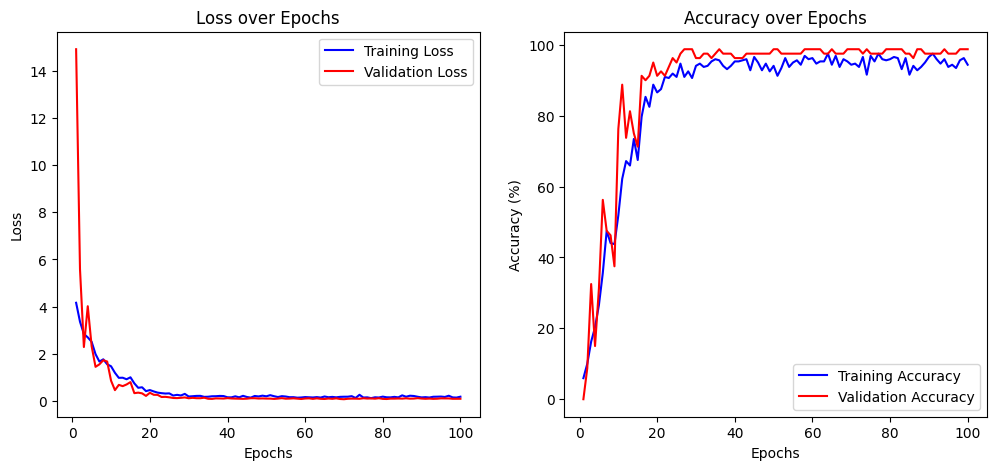

In [96]:
import os, glob
from PIL import Image

# ORL数据集加载器
class ORLDataset(Dataset):
  def __init__(self, root, transform=None, train_ratio=0.8, train=True):
    self.transform = transform
    self.images, self.labels = [], []
    self.class_names = []
    self._load_orl_dataset(root, train_ratio, train)

  def _load_orl_dataset(self, root, train_ratio, train):
    pgm_files = glob.glob(os.path.join(root, '**/*.pgm'), recursive=True)
    print(f"Found {len(pgm_files)} image files")

    subject_dict = {}
    for file_path in pgm_files:
      subject_id = os.path.basename(os.path.dirname(file_path))
      if subject_id not in subject_dict:
        subject_dict[subject_id] = []
      subject_dict[subject_id].append(file_path)

    self.class_names = sorted(subject_dict.keys())

    for subject_id, subject_name in enumerate(self.class_names):
      images = sorted(subject_dict[subject_name])
      split_index = int(len(images)*train_ratio)
      if train:
        selected_images = images[:split_index]
      else:
        selected_images = images[split_index:]
      for img_path in selected_images:
        self.images.append(img_path)
        self.labels.append(subject_id)
    print(f"{'Training' if train else 'Testing'} set: {len(self.images)} images")
  
  def __len__(self):
    return len(self.images)
  
  def __getitem__(self, index):
    img_path = self.images[index]
    label = self.labels[index]
    try:
      image = Image.open(img_path)
      if image.mode != 'L':
        image = image.convert('L')    # 'L'代表Luminance,即灰度图
    except Exception as e:
      print(f"Error loading image {img_path}: {e}")
      image = Image.new('L', (92, 112))  # 创建一个空白图像以防止崩溃
    if self.transform:
      image = self.transform(image)
    return image, label

# torch.manual_seed(42)
num_classes = 40
batch_size = 8
learning_rate = 0.005
# momentum = 0.9
weight_decay = 5e-4
epochs = 100
step_size = 5
gamma = 0.5
num_workers = 0

train_transform = transforms.Compose([
  transforms.Resize((224, 224)),
  transforms.RandomRotation(degrees=10),
  transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),
  transforms.RandomHorizontalFlip(p=0.5),
  transforms.ColorJitter(brightness=0.2, contrast=0.2),
  transforms.ToTensor(),
  transforms.Normalize(mean=[0.5], std=[0.5])
])
val_transform = transforms.Compose([
  transforms.Resize((224, 224)),
  transforms.ToTensor(),
  transforms.Normalize(mean=[0.5], std=[0.5])
])

print('loading data...')
data_loader_factory = DataLoaderFactory(dataset=ORLDataset, 
                                        batch_size=batch_size, num_workers=num_workers)
train_loader, val_loader = data_loader_factory.get_dataloaders(root='.\data',
                                                               train_transform=train_transform,
                                                               val_transform=val_transform)

print('initializing model...')
model = ResNet50(num_classes=num_classes).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(
  model.parameters(),
  lr=learning_rate,
  # momentum=momentum,
  weight_decay=weight_decay
)
scheduler = optim.lr_scheduler.StepLR(
  optimizer,
  step_size=step_size,
  gamma=gamma
)

print('starting training...')
trainer = Trainer(
  model=model,
  train_loader=train_loader,
  val_loader=val_loader,
  criterion=criterion,
  optimizer=optimizer,
  scheduler=scheduler
)
start_time = time.time()
trainer.train(num_epochs=epochs)
end_time = time.time()
print(f'Training completed in: {end_time - start_time:.2f} seconds')
plot_train_history(trainer)

* 奇怪的现象：去掉残差求和之后的ReLU激活函数后，深层网络在处理简单任务时的表现更好。  

在ResNet50处理ORL人脸识别任务时的表现如下：  
ReLU:  
  训练30趟 85% 78% 83% 70% 83%  
  训练100趟 训练准确率最高90% 测试准确率最高95%  

无激活函数：  
  训练30趟 97% 97% 95% 96% 95% 99%   
  训练100趟 训练准确率最高95% 测试准确率最高98%  